Might not run here becauseoriginally run in google colab. 
Link here: https://colab.research.google.com/drive/181kqnOg8RpMPW_tT9dZ8mhtIxACzzb_T?usp=sharing

# Install Detectron2 and Dependencies

In [1]:
#install torch (a computer vision library) and cuda (a way of interacting w the gpu):
!pip install torch==1.7.0+cu101 torchvision==0.8.1+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# install dependencies. pycoco is for the coco dataset
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision

# install detectron2 (Facebook's vision library)
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html 

#install a compatible pillow version (imaging library)
!pip install pillow==7.2

Looking in links: https://download.pytorch.org/whl/torch_stable.html
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 1.4MB/s 
     |████████████████████████████████| 2.2MB 5.5MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20210113-cp36-none-any.whl size=40828 sha256=0765014c8ea140694c77cdea6e5f36905c78193ab76d95c5c9124a232e2f2019
  Stored in directory: /root/.cache/pip/wheels/73/95/74/05b31b5b609a3dd9f0755bc4bd95eef60f2cb997cb5678a8dd
  Created wheel for iopath: filename=iopath-0.1.2-cp36-none-any.whl size=10508 sha256=7afa218c08f7ea030b76d0db65b2a8969b9e8be774f1fed5b3c749d941027561
  Stored in directory: /root/.cache/pip/wheels/9e/01/e4/1b68f5a2a6b9450ea4246d91840a77e1169f7d4722d76bbc47
Successfully built fvcore iopath
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
   

     |████████████████████████████████| 2.2MB 4.3MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 8.1.0
    Uninstalling Pillow-8.1.0:
      Successfully uninstalled Pillow-8.1.0


In [2]:
# detectron2 logger (records relevant info)
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import necessary detectron2 utilities
from detectron2 import model_zoo #where you will grab your specific model training framework from, we want to do object detection
from detectron2.engine import DefaultPredictor 
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer 
from detectron2.data import MetadataCatalog, DatasetCatalog

# other necessary libraries
import numpy as np 
import os, json, cv2, random #cv2 is open cv equivalent wo some of the troubleshooting issues (ex: image doesn't go away after showing)
from google.colab.patches import cv2_imshow

import tqdm
import time

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



# Importing Dataset

My Dataset was created pulling 1700 still shots from 34 videos featuring parking enforcement vehicles, which were labeled with Sixgill Sense and exported in the COCO format. I found the most efficient way to access my dataset was to upload my dataset (the img and 3 json files from the COCO dataset) to google drive and then mount the drive to that location.

*note: if I wanted to expand my dataset in the future, this method may not be as feasible as the default free google drive storage is 15 GB and paying for more means $1.99/month. The dataset as it stands now is about 3.9 GB

The below code mounts the data to the Google Drive, then sets up the train, test, validation files to be read in correctly via the COCO format

In [3]:
from google.colab import drive
from detectron2.data.datasets import register_coco_instances

def load_data_in_colab(train_file_path, validation_file_path, test_file_path, project_folder_path):
  '''
  If you are using google colab, you should mount your data to your google drive for continuous access without having to reupload data after a timeout message. 
  Then after uploading the img file and 3 json files to Google Drive, pass in the pathways to each file. Make sure the file paths are encased in quotes.

  Inputs: 
      directory: path to directory with images/json files (as a string)
  Output:
      'success' message
  '''

  drive.mount("/content/drive")

  register_coco_instances("my_dataset_train", {}, train_file_path, project_folder_path)
  register_coco_instances("my_dataset_val", {}, validation_file_path, project_folder_path)
  register_coco_instances("my_dataset_test", {}, test_file_path, project_folder_path)
  print(f"Success! Your data is mounted to Google Drive.")

In [4]:
load_data_in_colab("/content/drive/MyDrive/parking_enforcement_data/train.json", "/content/drive/MyDrive/parking_enforcement_data/validation.json", "/content/drive/MyDrive/parking_enforcement_data/test.json", "/content/drive/MyDrive/parking_enforcement_data")

Mounted at /content/drive
Success! Your data is mounted to Google Drive.


In [5]:
# you can see here your COCO files have been uploaded successfully and can be accessed via colab
# if successful, output should read: "img  test.json	train.json  validation.json"

!ls "/content/drive/My Drive/parking_enforcement_data"

img  test.json	train.json  validation.json


Now we check that the dataset is reading correctly by pulling however many random sample images from our data dictionary and show them with our labeled bounding boxes

In [6]:
def show_random_images(number_of_random_images):
  '''
  Let's make sure that our dataset images and annotations are reading in correctly by showing three random images from our training set and their corresponding bounding boxes. 
  Below, the code says: we'd like to create a dictionary variable to store information of our images. 
  Then, pull 'x' number of random images from that dictionary and for each of them, read it in using open cv, and plot and show the bounding boxes.
  You can run this as many times as you want.
  
  Input:
      number of random images to show (int)
  Output:
      images with bounding boxes
  '''

  my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train") 
  dataset_dicts = DatasetCatalog.get("my_dataset_train") 

  for image in random.sample(dataset_dicts, number_of_random_images): 
      img = cv2.imread(image["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5) #the negative indexing reformats the 'BGR' pixels to correct format of 'RGB'
      out = visualizer.draw_dataset_dict(image) 
      cv2_imshow(out.get_image()[:, :, ::-1]) 

# set meta data for validation set (we'll use this later for testing)
test_metadata = MetadataCatalog.get("my_dataset_test")

[01/14 15:46:02 d2.data.datasets.coco]: Loaded 1352 images in COCO format from /content/drive/MyDrive/parking_enforcement_data/train.json


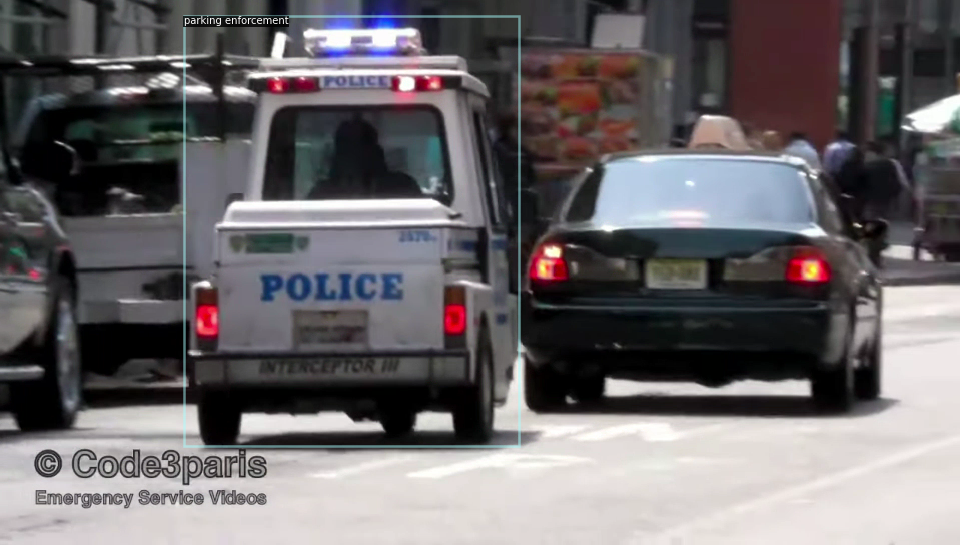

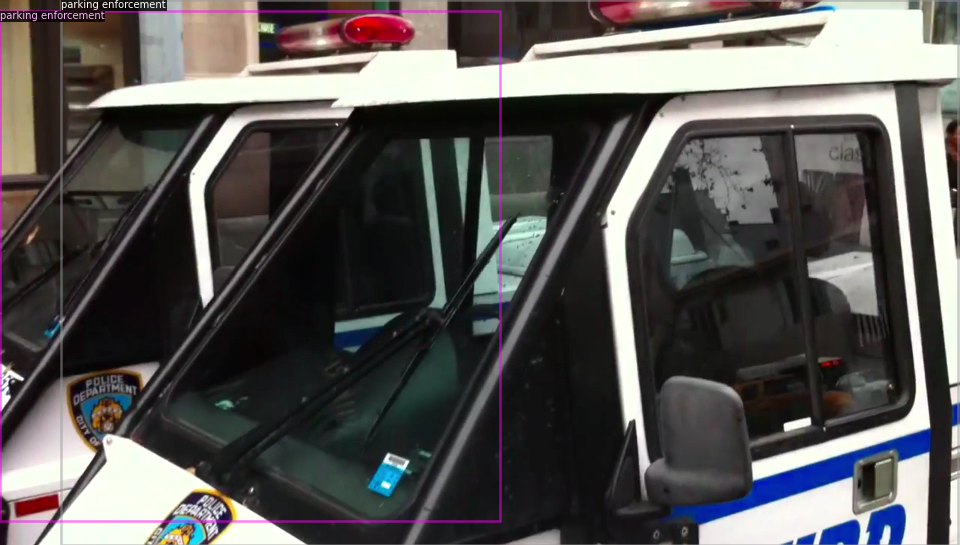

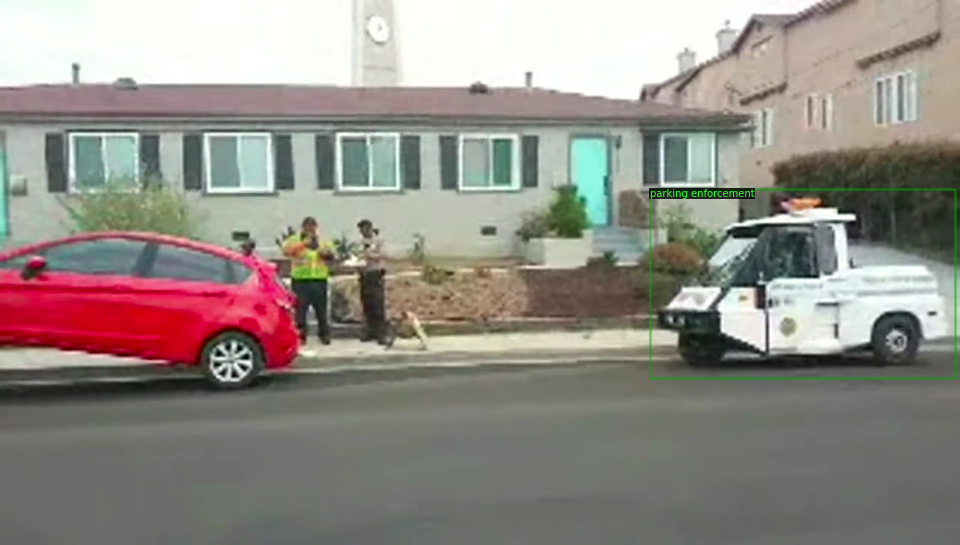

In [7]:
show_random_images(3)

Below is what one example inside the dataset dictionary looks like and how it is structure. The dataset dictionary is a giant dictionary of our train images info: their height, width, bounding boxs coordinates, url to image, etc.

# Use an Object Detection Detectron2 Model to Train Your Data



In [9]:
# unfortunately detectron2 doesn't have a built in way to do validation as you're training the model so
# the below code will feed in the evaluation dataset into the model as it's being trained

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class MyTrainer(DefaultTrainer):
  @classmethod
  '''
  because detectron2 doesn't have a built in way to do validation as you're training the model, this is a custom way to do it.
  so if an output folder is not yet created (iterations not done running), then this code will keep feeding validation.
  '''
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):
    if output_folder is None:
      output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
    return COCOEvaluator(dataset_name, cfg, True, output_folder)


Now we can actually get to the training. The model we are using is "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml" from ModelZoo. 

In [16]:
# now we train our object detection model using "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml" from ModelZoo!

from detectron2.engine import DefaultTrainer

def train_data(model_type, learning_rate, iterations, number_classes, eval_message):

  cfg = get_cfg() # start detectron2's default config
  cfg.merge_from_file(model_zoo.get_config_file(model_type)) # we are going to load in our model type
  cfg.DATASETS.TRAIN = ("my_dataset_train",) # <- don't forget comma at end, otherwise it will throw an error. it's expecting a tuple datatype to run

  cfg.DATALOADER.NUM_WORKERS = 0 # higher number means more subprocesses to use for data loading. default is 0
  cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(model_type) # transfer learning: let training initialize from the above architecture that and use those weights included 
  cfg.SOLVER.IMS_PER_BATCH = 2 # image per batch per GPU
  cfg.SOLVER.BASE_LR = learning_rate
  cfg.SOLVER.MAX_ITER = iterations
  cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32   # this is saying how many instances per image we are going to look at. default is 512 but we don't need that many
  cfg.MODEL.ROI_HEADS.NUM_CLASSES = number_classes 

  os.makedirs(cfg.OUTPUT_DIR, exist_ok=True) #this is saving our model during training in a newly made output folder

  cfg.DATASETS.TEST = ("my_dataset_val",) # testing on our validation
  cfg.TEST.EVAL_PERIOD = eval_message # this says every 'x' cycles, run our model on validation dataset and give us an output (should show improvement)
  trainer = MyTrainer(cfg)

  trainer.resume_or_load(resume=False)
  trainer.train()

In [17]:
train_data("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml", 0.001, 10, 1, 10)

[01/14 16:19:08 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.


[01/14 16:19:08 d2.engine.train_loop]: Starting training from iteration 0
[01/14 16:20:06 d2.data.datasets.coco]: Loaded 169 images in COCO format from /content/drive/MyDrive/parking_enforcement_data/validation.json
[01/14 16:20:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/14 16:20:06 d2.data.common]: Serializing 169 elements to byte tensors and concatenating them all ...
[01/14 16:20:06 d2.data.common]: Serialized dataset takes 0.05 MiB
WARNING [01/14 16:20:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/14 16:20:06 d2.evaluation.evaluator]: Start inference on 169 images
[01/14 16:20:17 d2.evaluation.evaluator]: Inference done 11/169. 0.7990 s / img. ETA=0:02:28
[01/14 16:20:23 d2.evaluation.evaluator]: Inference done 17/169. 0.7987 s / img. ETA=0:02:24
[01/14 16:20:28 d2

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Use the Trained Model on Test Set

In [18]:
# this is where our trained model lives
!ls ./output/

coco_instances_results.json			  instances_predictions.pth
events.out.tfevents.1610639232.73dec1591cc3.61.0  last_checkpoint
events.out.tfevents.1610641148.73dec1591cc3.61.1  metrics.json
inference					  model_final.pth


In [20]:
# we are now going to load this model that we trained so we can use it on test set

def test_data(model_type, number_classes, threshold):

  cfg = get_cfg()
  cfg.merge_from_file(model_zoo.get_config_file(model_type)) # has to be same as your starting model architecture
  cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth") # instead of using the predefined weights, we want to tell it to use our saved model weights (transfer learning)
  cfg.DATASETS.TEST = ("my_dataset_test", ) # loading in our test dataset
  cfg.MODEL.ROI_HEADS.NUM_CLASSES = number_classes #if you have more than one class remember to update this
  cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = threshold # will only draw a bounding box if the guess is above "x" percent confidence

  predictor = DefaultPredictor(cfg) # this is our variable to pass in an image and get some result

In [21]:
test_data("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml", 1, .90)

In [24]:
# Run test on just one image

from detectron2.utils.visualizer import ColorMode

def test_one_image(image_name):
  test_image_path = f'/content/drive/MyDrive/parking_enforcement_data/img/{image_name}' # make sure this image hasn't been trained on
  im = cv2.imread(test_image_path)
  outputs = predictor(im) # this gives us where to draw and the classification
  v = Visualizer(im[:, :, ::-1],
                  metadata=test_metadata, 
                  scale=0.5
      ) # similar to before we are drawing out our visualization
  out = v.draw_instance_predictions(outputs["instances"].to("cpu")) # when you run a model or train a model you're often using gpu, but when you're outputting an image or drawing you want to use cpu
  cv2_imshow(out.get_image()[:, :, ::-1])

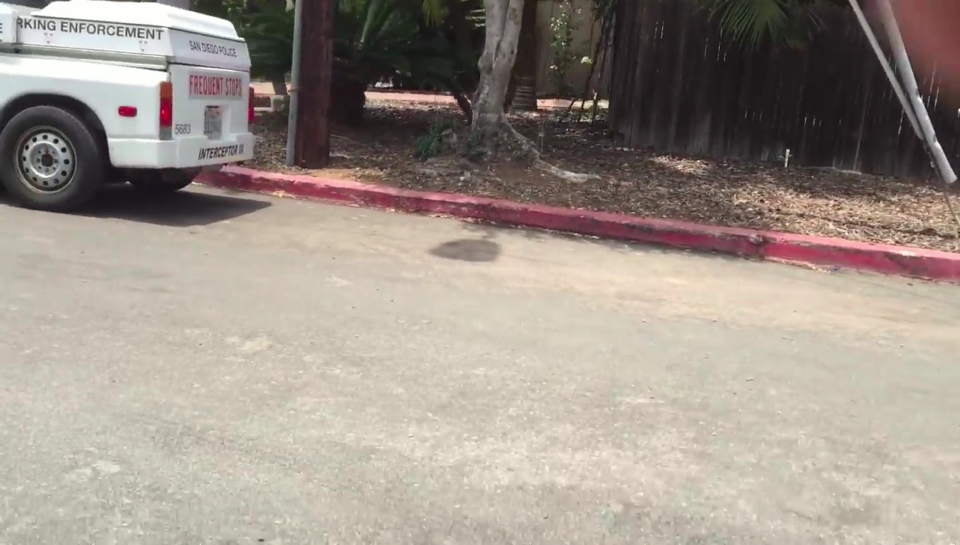

In [26]:
test_one_image('01EVBVP2SPADEXN0G6Z3CFSZDG.png') # remember to put in quotes

### Evaluation metrics

Average Precision (AP) is the main metric of detectron2's COCO Evaluator 

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [01/14 16:40:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/14 16:40:25 d2.data.datasets.coco]: Loaded 169 images in COCO format from /content/drive/MyDrive/parking_enforcement_data/test.json
[01/14 16:40:25 d2.data.build]: Distribution of instances among all 1 categories:
|   category    | #instances   |
|:-------------:|:-------------|
| parking enf.. | 190          |
|               |              |
[01/14 16:40:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/14 16:40:25 d2.data.common]: Serializing 169 elements to byte tensors and concatenating them all ...
[01/14 16:40:25 d2.data.common]: Serialized dataset takes 0.05 MiB
[01/14 16:40:25 d2.evaluation.evaluator]: Start inference on 169 images
[01/14 16:40:36 d2.evaluation.evaluator]: Inference done 11/169. 0.809